# Prepossing of the data and libraries:

In [2]:
pip install pandas_profiling

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [3]:
pip install plotly_express

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Loading the required packages:

In [4]:
# Load the Drive helper and mount
from google.colab import drive
drive.mount('/content/drive')

import os
os.chdir("/content/drive/My Drive")
#!ls

import os
# get the device on your machine
import keras
from torch.utils.data import Dataset, DataLoader, random_split, Subset
import torch.nn.functional as F
from sklearn.metrics import classification_report
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly_express as px
import plotly.graph_objects as go
from pandas.io.json import json_normalize 
import seaborn as sns
sns.set()
import pandas_profiling


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<ipython-input-4-2179abab4274>:27: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  import pandas_profiling


Loading the data file

In [5]:
filepath = r"/content/drive/My Drive/AML/public_up_to_150k_1_230331.csv"
df = pd.read_csv(filepath)

Getting the basic information about the data

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 900000 entries, 0 to 899999
Data columns (total 53 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   LoanNumber                   900000 non-null  int64  
 1   DateApproved                 900000 non-null  object 
 2   SBAOfficeCode                899973 non-null  float64
 3   ProcessingMethod             900000 non-null  object 
 4   BorrowerName                 899999 non-null  object 
 5   BorrowerAddress              899859 non-null  object 
 6   BorrowerCity                 899858 non-null  object 
 7   BorrowerState                899849 non-null  object 
 8   BorrowerZip                  899860 non-null  object 
 9   LoanStatusDate               860161 non-null  object 
 10  LoanStatus                   900000 non-null  object 
 11  Term                         900000 non-null  int64  
 12  SBAGuarantyPercentage        900000 non-null  int64  
 13 

To check number of nulls/NaN in the columns:

In [ ]:
# Function to count null values in each column
def count_nulls(dataframe):
    null_counts = {}
    null_counts_perc = {}
    for col in dataframe.columns:
        null_counts[col] = dataframe[col].isnull().sum()
        null_counts_perc[col] = dataframe[col].isnull().sum() / len(dataframe)
    return null_counts, null_counts_perc

# Call the function on the DataFrame
null_counts, null_counts_perc = count_nulls(df)

# Print the results
for col, count_perc in null_counts_perc.items():
    print(f"Percentage of null values in '{col}': {count_perc * 100:.2f}%")


Percentage of null values in 'LoanNumber': 0.00%
Percentage of null values in 'DateApproved': 0.00%
Percentage of null values in 'SBAOfficeCode': 0.00%
Percentage of null values in 'ProcessingMethod': 0.00%
Percentage of null values in 'BorrowerName': 0.00%
Percentage of null values in 'BorrowerAddress': 0.02%
Percentage of null values in 'BorrowerCity': 0.02%
Percentage of null values in 'BorrowerState': 0.02%
Percentage of null values in 'BorrowerZip': 0.02%
Percentage of null values in 'LoanStatusDate': 4.43%
Percentage of null values in 'LoanStatus': 0.00%
Percentage of null values in 'Term': 0.00%
Percentage of null values in 'SBAGuarantyPercentage': 0.00%
Percentage of null values in 'InitialApprovalAmount': 0.00%
Percentage of null values in 'CurrentApprovalAmount': 0.00%
Percentage of null values in 'UndisbursedAmount': 0.01%
Percentage of null values in 'FranchiseName': 98.42%
Percentage of null values in 'ServicingLenderLocationID': 0.00%
Percentage of null values in 'Servici

Data prepocessing:


*   Concatenating borrower's name and city, borrower's name and state to look for duplicated entry
*   Dealing with Nan values



In [7]:
df['name_city'] = df['BorrowerName'] + '_' + df['BorrowerCity']
df['name_state'] = df['BorrowerName'] + '_' + df['BorrowerState']
df['forgiven'] = np.where(df['ForgivenessDate'].isnull() | df['ForgivenessDate'].eq(''), 0, 1)


for col in df.columns:
    if df[col].dtype == 'float64' or df[col].dtype == 'int64':
        df[col].fillna(0, inplace=True)
    elif df[col].dtype == 'object':
        df[col].fillna('unknown', inplace=True)

Creating a list of categorical and numerical columns for further preprocessing

In [8]:
# create empty lists to hold column names for numerical and categorical data
numerical_cols = []
categorical_cols = []

# loop over each column and check the data type
for col in df.columns:
    if df[col].dtype == "object":
        # categorical column
        categorical_cols.append(col)
    else:
        # numerical column
        numerical_cols.append(col)

# print the results
print("Numerical columns: ", numerical_cols)
print("Categorical columns: ", categorical_cols)

Numerical columns:  ['LoanNumber', 'SBAOfficeCode', 'Term', 'SBAGuarantyPercentage', 'InitialApprovalAmount', 'CurrentApprovalAmount', 'UndisbursedAmount', 'ServicingLenderLocationID', 'JobsReported', 'NAICSCode', 'UTILITIES_PROCEED', 'PAYROLL_PROCEED', 'MORTGAGE_INTEREST_PROCEED', 'RENT_PROCEED', 'REFINANCE_EIDL_PROCEED', 'HEALTH_CARE_PROCEED', 'DEBT_INTEREST_PROCEED', 'OriginatingLenderLocationID', 'ForgivenessAmount', 'forgiven']
Categorical columns:  ['DateApproved', 'ProcessingMethod', 'BorrowerName', 'BorrowerAddress', 'BorrowerCity', 'BorrowerState', 'BorrowerZip', 'LoanStatusDate', 'LoanStatus', 'FranchiseName', 'ServicingLenderName', 'ServicingLenderAddress', 'ServicingLenderCity', 'ServicingLenderState', 'ServicingLenderZip', 'RuralUrbanIndicator', 'HubzoneIndicator', 'LMIIndicator', 'BusinessAgeDescription', 'ProjectCity', 'ProjectCountyName', 'ProjectState', 'ProjectZip', 'CD', 'Race', 'Ethnicity', 'BusinessType', 'OriginatingLender', 'OriginatingLenderCity', 'OriginatingLe

In [ ]:
df.head(200)

,LoanNumber,DateApproved,SBAOfficeCode,ProcessingMethod,BorrowerName,BorrowerAddress,BorrowerCity,BorrowerState,BorrowerZip,LoanStatusDate,...,OriginatingLenderCity,OriginatingLenderState,Gender,Veteran,NonProfit,ForgivenessAmount,ForgivenessDate,name_city,name_state,forgiven
0,3509338307,01/22/2021,0.0,PPS,Exemption 6,unknown,unknown,unknown,unknown,02/18/2022,...,unknown,unknown,Unanswered,Unanswered,Y,150775.38,01/13/2022,unknown,unknown,1
1,5375617707,05/01/2020,101.0,PPP,NOT AVAILABLE,unknown,unknown,unknown,unknown,07/16/2021,...,CHARLOTTE,NC,Unanswered,Unanswered,unknown,150083.01,06/11/2021,unknown,unknown,1
2,9677497701,05/01/2020,464.0,PPP,NORTH CHARLESTON HOSPITALITY GROUP LLC,192 College Park Rd,Ladson,unknown,29456-3517,09/25/2021,...,COLUMBUS,GA,Unanswered,Unanswered,unknown,141920.11,08/25/2021,NORTH CHARLESTON HOSPITALITY GROUP LLC_Ladson,unknown,1
3,9547167709,05/01/2020,464.0,PPP,Q AND J SERVICES LLC,301 Old Georgetown Road,Manning,unknown,29102-2734,04/20/2021,...,COLUMBUS,GA,Unanswered,Unanswered,unknown,137747.78,03/29/2021,Q AND J SERVICES LLC_Manning,unknown,1
4,8885207205,04/28/2020,0.0,PPP,Exemption 6,unknown,unknown,unknown,unknown,05/20/2021,...,unknown,unknown,Unanswered,Unanswered,Y,131876.98,04/27/2021,unknown,unknown,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,3875607102,04/12/2020,1084.0,PPP,"BLUE HOLE PROPERTIES, LLC",HC-1 Box 84,Valdez,AK,99686,04/22/2021,...,SAN FRANCISCO,CA,Unanswered,Unanswered,unknown,149410.58,03/02/2021,"BLUE HOLE PROPERTIES, LLC_Valdez","BLUE HOLE PROPERTIES, LLC_AK",1
196,9614047110,04/15/2020,1084.0,PPP,"DOUBLE B, LLC",1507 N DOUBLE B ST,PALMER,AK,99645,06/29/2021,...,ANCHORAGE,AK,Male Owned,Unanswered,unknown,149808.22,06/16/2021,"DOUBLE B, LLC_PALMER","DOUBLE B, LLC_AK",1
197,4600837009,04/04/2020,1084.0,PPP,ALASKA CENTER FOR CREATIVE RENEWAL,46877 Stillpoint Trail,HALIBUT COVE,AK,99603-6401,06/19/2021,...,ANCHORAGE,AK,Unanswered,Unanswered,unknown,149633.29,05/11/2021,ALASKA CENTER FOR CREATIVE RENEWAL_HALIBUT COVE,ALASKA CENTER FOR CREATIVE RENEWAL_AK,1
198,5175837208,04/27/2020,1084.0,PPP,COVENANT YOUTH OF ALASKA,228 W 11th Ave,Anchorage,AK,99501,04/21/2021,...,ANCHORAGE,AK,Male Owned,Unanswered,Y,149261.37,03/02/2021,COVENANT YOUTH OF ALASKA_Anchorage,COVENANT YOUTH OF ALASKA_AK,1


To verify the number of NaN in columns:



In [9]:
# Function to count null values in each column
def count_nulls(dataframe):
    null_counts = {}
    null_counts_perc = {}
    for col in dataframe.columns:
        null_counts[col] = dataframe[col].isnull().sum()
        null_counts_perc[col] = dataframe[col].isnull().sum() / len(dataframe)
    return null_counts, null_counts_perc

# Call the function on the DataFrame
null_counts, null_counts_perc = count_nulls(df)

# Print the results
for col, count_perc in null_counts_perc.items():
    print(f"Percentage of null values in '{col}': {count_perc * 100:.2f}%")


Percentage of null values in 'LoanNumber': 0.00%
Percentage of null values in 'DateApproved': 0.00%
Percentage of null values in 'SBAOfficeCode': 0.00%
Percentage of null values in 'ProcessingMethod': 0.00%
Percentage of null values in 'BorrowerName': 0.00%
Percentage of null values in 'BorrowerAddress': 0.00%
Percentage of null values in 'BorrowerCity': 0.00%
Percentage of null values in 'BorrowerState': 0.00%
Percentage of null values in 'BorrowerZip': 0.00%
Percentage of null values in 'LoanStatusDate': 0.00%
Percentage of null values in 'LoanStatus': 0.00%
Percentage of null values in 'Term': 0.00%
Percentage of null values in 'SBAGuarantyPercentage': 0.00%
Percentage of null values in 'InitialApprovalAmount': 0.00%
Percentage of null values in 'CurrentApprovalAmount': 0.00%
Percentage of null values in 'UndisbursedAmount': 0.00%
Percentage of null values in 'FranchiseName': 0.00%
Percentage of null values in 'ServicingLenderLocationID': 0.00%
Percentage of null values in 'Servicin

Converting all the columns to lowercase:

In [10]:
cat_cols = ['DateApproved', 'ProcessingMethod', 'BorrowerName', 'BorrowerAddress', 'BorrowerCity', 
            'BorrowerState', 'BorrowerZip', 'LoanStatusDate', 'LoanStatus', 'FranchiseName', 
            'ServicingLenderName', 'ServicingLenderAddress', 'ServicingLenderCity', 
            'ServicingLenderState', 'ServicingLenderZip', 'RuralUrbanIndicator', 'HubzoneIndicator', 
            'LMIIndicator', 'BusinessAgeDescription', 'ProjectCity', 'ProjectCountyName', 'ProjectState', 
            'ProjectZip', 'CD', 'Race', 'Ethnicity', 'BusinessType', 'OriginatingLender', 
            'OriginatingLenderCity', 'OriginatingLenderState', 'Gender', 'Veteran', 'NonProfit', 
            'ForgivenessDate', 'name_city', 'name_state']

# loop through all categorical columns and convert values to lowercase
for col in cat_cols:
    if df[col].dtype == 'object':
        df[col] = df[col].str.lower()

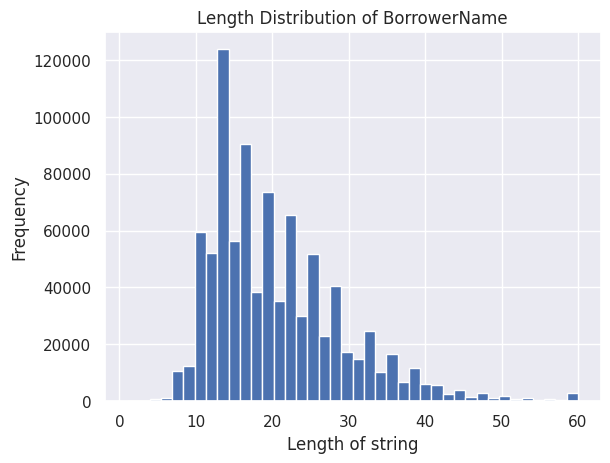

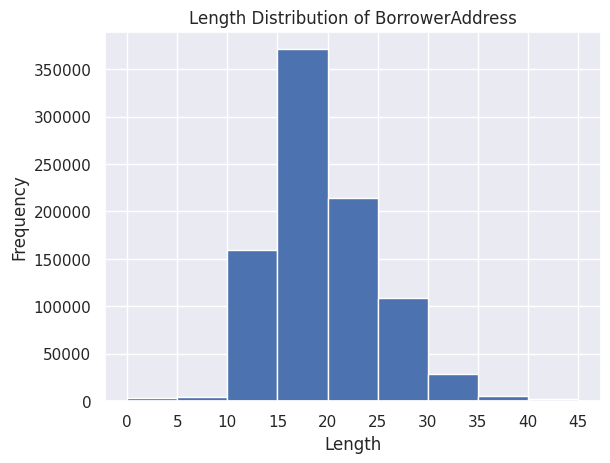

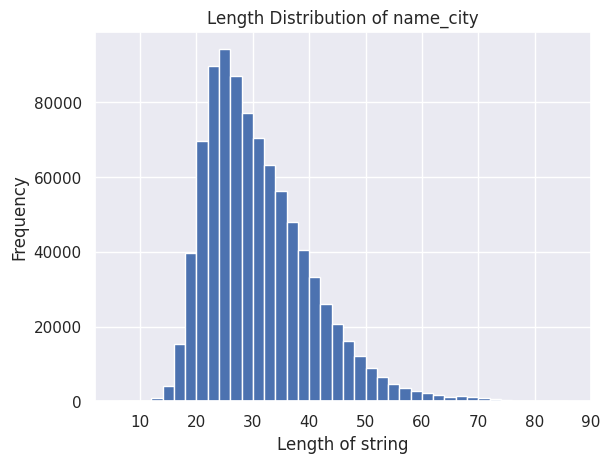

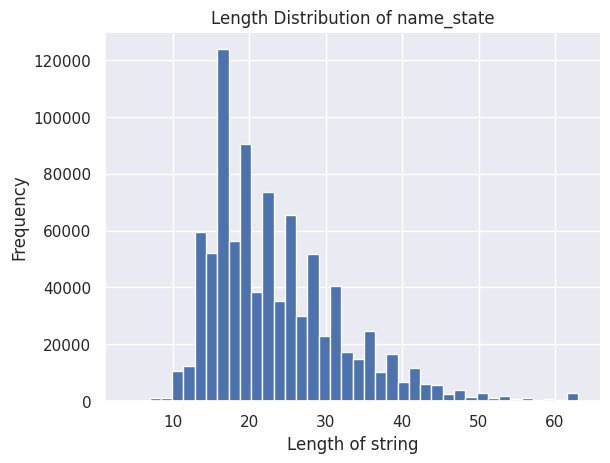

In [ ]:
# Select the column of interest with dtype=object
col = df['BorrowerName']

# Convert the column to a string and calculate the length of each string
string_lengths = col.astype(str).apply(len)

# Plot a histogram of the string lengths
plt.hist(string_lengths, bins=40)

# Add labels and title to the plot
plt.xlabel('Length of string')
plt.ylabel('Frequency')
plt.title('Length Distribution of BorrowerName')

# Display the plot
plt.show()


# Select the column of interest with dtype=object
col = df['BorrowerAddress']

# Convert the column to a string and calculate the length of each string
lengths = col.astype(str).apply(len)

# Plot the histogram
fig, ax = plt.subplots()
n, bins, patches = ax.hist(lengths, bins=range(0, 50, 5))

# Set the x-axis ticks at a distance of 5
plt.xticks(range(0, 50, 5))

# Set the plot title and labels
ax.set_title('Length Distribution of BorrowerAddress')
ax.set_xlabel('Length')
ax.set_ylabel('Frequency')

# Show the plot
plt.show()

# Select the column of interest with dtype=object
col = df['name_city']

# Convert the column to a string and calculate the length of each string
string_lengths = col.astype(str).apply(len)

# Plot a histogram of the string lengths
plt.hist(string_lengths, bins=40)

# Add labels and title to the plot
plt.xlabel('Length of string')
plt.ylabel('Frequency')
plt.title('Length Distribution of name_city')

# Display the plot
plt.show()

# Select the column of interest with dtype=object
col = df['name_state']

# Convert the column to a string and calculate the length of each string
string_lengths = col.astype(str).apply(len)

# Plot a histogram of the string lengths
plt.hist(string_lengths, bins=40)

# Add labels and title to the plot
plt.xlabel('Length of string')
plt.ylabel('Frequency')
plt.title('Length Distribution of name_state')

# Display the plot
plt.show()

In [ ]:
# Basic statistics of the data
print("Basic Statistics of the Data:")
print(df.describe())

# Missing values in the data
print("\nMissing Values in the Data:")
print(df.isnull().sum())

# Unique values in each column
print("\nUnique Values in Each Column:")
print(df.nunique())

# Distribution of values in categorical columns
print("\nDistribution of Values in Categorical Columns:")
categorical_columns = df.select_dtypes(include='object').columns  # Assuming categorical columns are of 'object' data type
for col in categorical_columns:
    print(f"Column: {col}")
    print(df[col].value_counts(normalize=True))
    print()

# Distribution of values in numerical columns
print("\nDistribution of Values in Numerical Columns:")
numerical_columns = df.select_dtypes(include=np.number).columns  # Assuming numerical columns are of numeric data types
for col in numerical_columns:
    print(f"Column: {col}")
    print(df[col].describe())
    print()


Basic Statistics of the Data:
         LoanNumber  SBAOfficeCode           Term  SBAGuarantyPercentage  \
count  9.000000e+05  900000.000000  900000.000000               900000.0   
mean   5.394218e+09     827.949792      43.782781                  100.0   
std    2.545726e+09     193.986837      17.967141                    0.0   
min    1.000009e+09       0.000000       0.000000                  100.0   
25%    3.198504e+09     669.000000      24.000000                  100.0   
50%    5.374667e+09     914.000000      60.000000                  100.0   
75%    7.496290e+09     942.000000      60.000000                  100.0   
max    9.998978e+09    9030.000000     120.000000                  100.0   

       InitialApprovalAmount  CurrentApprovalAmount  UndisbursedAmount  \
count           9.000000e+05          900000.000000      900000.000000   
mean            4.116123e+04           40752.907367           0.638504   
std             4.798045e+04           34625.060134         162

# Exploratory Data Analysis (EDA)

In [ ]:
pandas_profiling.ProfileReport(df)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Transforming the categorical variables through Label Encoder:

In [ ]:
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()
categorical_columns = ['ProcessingMethod',
            'BorrowerZip', 'LoanStatus',
            'ServicingLenderName', 
            'RuralUrbanIndicator', 'HubzoneIndicator', 
            'LMIIndicator', 'BusinessAgeDescription',
            'ProjectZip', 'Race', 'Ethnicity', 'BusinessType', 'OriginatingLender', 
            'Gender', 'Veteran', 'NonProfit']

for col in categorical_columns:
    df[col] = le.fit_transform(df[col])


# Trying out Classifier Model:

we have variables that identify when the loan was forgiven for a borrower. We can use this variable as a proxy, to know for which customers the loan was
forgiven. Although, we realize that the not all the customers whoose loan was forgiven will be guilty of doing the fraud. But if the bank can know, beforehand, while the customer submits their initial information, that we might have to forgive this particular person's loan down the years, then the bank can make a decision to not give loan to that person. 

Choosing only the variables that are needed to include in the classifier model

In [ ]:
desired_vars = ['SBAOfficeCode','ProcessingMethod', 'BorrowerCity', 'BorrowerState',
            'BorrowerZip', 'LoanStatus'
            'ServicingLenderName', 
            'RuralUrbanIndicator', 'HubzoneIndicator', 
            'LMIIndicator', 'BusinessAgeDescription',
            'ProjectZip', 'Race', 'Ethnicity', 'BusinessType', 'OriginatingLender', 
            'Gender', 'Veteran', 'NonProfit', 'Term', 'SBAGuarantyPercentage', 'InitialApprovalAmount', 'CurrentApprovalAmount', 'UndisbursedAmount', 
            'JobsReported', 'NAICSCode', 'UTILITIES_PROCEED', 'PAYROLL_PROCEED', 'MORTGAGE_INTEREST_PROCEED', 'RENT_PROCEED', 'REFINANCE_EIDL_PROCEED', 'HEALTH_CARE_PROCEED', 
            'DEBT_INTEREST_PROCEED', 'forgiven']
classifier_df = df[desired_vars]

X = classifier_df.drop('forgiven', axis=1)
y = classifier_df['forgiven']

Balancing the dataset. The non-forgiven observations are only 7%. Running a random forest classifier for classify 

In [ ]:
from imblearn.under_sampling import RandomUnderSampler
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn.model_selection import train_test_split

# Assuming 'X' is your independent variables dataframe and 'y' is your target variable series
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Balance the classes using RandomUnderSampler
rus = RandomUnderSampler(random_state=42)
X_train_resampled, y_train_resampled = rus.fit_resample(X_train, y_train)

# Fit random forest classifier on the balanced dataset
rf = RandomForestClassifier(n_estimators=300, max_depth=100, random_state=42)
rf.fit(X_train_resampled, y_train_resampled)

# Predict on test set and evaluate performance
y_pred = rf.predict(X_test)
print("Accuracy:", accuracy_score(y_test, y_pred))
print("Classification Report:\n", classification_report(y_test, y_pred))
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred))


Accuracy: 0.8640518518518518
Classification Report:
               precision    recall  f1-score   support

           0       0.32      0.86      0.47     18888
           1       0.99      0.86      0.92    251112

    accuracy                           0.86    270000
   macro avg       0.66      0.86      0.70    270000
weighted avg       0.94      0.86      0.89    270000

Confusion Matrix:
 [[ 16298   2590]
 [ 34116 216996]]


In [ ]:
conf_mat = confusion_matrix(y_test, y_pred)

# Add headings
print('Confusion Matrix')
print('------------------------------')
print('               Actual')
print('             |  NF   |  F  |')
print('------------------------------')
print(f'Predicted NF | {conf_mat[0][0]:4d} | {conf_mat[0][1]:4d} |')
print(f'             |      |      |')
print(f'Predicted F | {conf_mat[1][0]:4d} | {conf_mat[1][1]:4d} |')
print('------------------------------')
print('True Positive (TP): ', conf_mat[1][1])
print('False Positive (FP): ', conf_mat[0][1])
print('True Negative (TN): ', conf_mat[0][0])
print('False Negative (FN): ', conf_mat[1][0])

Confusion Matrix
------------------------------
               Actual
             |  NF   |  F  |
------------------------------
Predicted NF | 16298 | 2590 |
             |      |      |
Predicted F | 34116 | 216996 |
------------------------------
True Positive (TP):  216996
False Positive (FP):  2590
True Negative (TN):  16298
False Negative (FN):  34116


Printing out the relative importance of the variables.

In [23]:
importances = rf.feature_importances_
feature_names = X.columns
importance_df = pd.DataFrame({'feature': feature_names, 'importance': importances})

# sort the DataFrame by importance score
importance_df = importance_df.sort_values('importance', ascending=False)

# print the top 10 most important features
print(importance_df.head(10))

                  feature  importance
15                   Term    0.218986
18  CurrentApprovalAmount    0.085125
20           JobsReported    0.080363
23        PAYROLL_PROCEED    0.078069
17  InitialApprovalAmount    0.073330
1             BorrowerZip    0.072150
7              ProjectZip    0.071713
21              NAICSCode    0.071522
2     ServicingLenderName    0.061693
11      OriginatingLender    0.058389


#Trying out Linear Regression:

There is a variable, Forgiven amount. We tried to estimate that using linear regression. The idea is that if the bank can know, at the time of lending, how much of that loan is going to be forgiven, they can make intelligent decision about weather or not to grant the loan.

In [24]:
desired_vars = ['ProcessingMethod',
            'BorrowerZip',
            'ServicingLenderName', 
            'RuralUrbanIndicator', 'HubzoneIndicator', 
            'LMIIndicator', 'BusinessAgeDescription',
            'ProjectZip', 'Race', 'Ethnicity', 'BusinessType', 'OriginatingLender', 
            'Gender', 'Veteran', 'NonProfit', 'Term', 'SBAGuarantyPercentage', 'InitialApprovalAmount', 'CurrentApprovalAmount', 'UndisbursedAmount', 
            'JobsReported', 'NAICSCode', 'UTILITIES_PROCEED', 'PAYROLL_PROCEED', 'MORTGAGE_INTEREST_PROCEED', 'RENT_PROCEED', 'REFINANCE_EIDL_PROCEED', 'HEALTH_CARE_PROCEED', 
            'DEBT_INTEREST_PROCEED', 'ForgivenessAmount']
classifier_df = df[desired_vars]

X = classifier_df.drop('ForgivenessAmount', axis=1)
y = classifier_df['ForgivenessAmount']

In [26]:
from sklearn.linear_model import LinearRegression, LassoCV, RidgeCV
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score

# Assuming 'X' is your feature matrix and 'y' is your target variable

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create a pipeline for preprocessing and linear regression
pipeline_lr = make_pipeline(StandardScaler(), LinearRegression())
pipeline_lasso = make_pipeline(StandardScaler(), LassoCV(cv=5))
pipeline_ridge = make_pipeline(StandardScaler(), RidgeCV(cv=5))

# Fit the models
pipeline_lr.fit(X_train, y_train)
pipeline_lasso.fit(X_train, y_train)
pipeline_ridge.fit(X_train, y_train)

# Predict on the test set
y_pred_lr = pipeline_lr.predict(X_test)
y_pred_lasso = pipeline_lasso.predict(X_test)
y_pred_ridge = pipeline_ridge.predict(X_test)

# Evaluate the models
print("Linear Regression:")
print("Mean Squared Error:", mean_squared_error(y_test, y_pred_lr))
print("R^2 Score:", r2_score(y_test, y_pred_lr))

print("\nLasso Regression:")
print("Mean Squared Error:", mean_squared_error(y_test, y_pred_lasso))
print("R^2 Score:", r2_score(y_test, y_pred_lasso))

print("\nRidge Regression:")
print("Mean Squared Error:", mean_squared_error(y_test, y_pred_ridge))
print("R^2 Score:", r2_score(y_test, y_pred_ridge))


Linear Regression:
Mean Squared Error: 87830993.38150439
R^2 Score: 0.9301997403318436

Lasso Regression:
Mean Squared Error: 87835910.1155115
R^2 Score: 0.9301958329490713

Ridge Regression:
Mean Squared Error: 87830942.71078365
R^2 Score: 0.9301997806004245


# Isolation Forest

In [13]:
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()
categorical_columns = ['SBAOfficeCode','ProcessingMethod', 'BorrowerCity', 'BorrowerState',
            'BorrowerZip', 'LoanStatus', 'ServicingLenderLocationID', 'ServicingLenderAddress', 'ServicingLenderCity', 'ServicingLenderState', 'ServicingLenderZip', 'ProjectCountyName',
            'ServicingLenderName', 'ProjectCity', 'ProjectState', 'CD',
            'RuralUrbanIndicator', 'HubzoneIndicator', 
            'LMIIndicator', 'BusinessAgeDescription', 'ForgivenessAmount',
            'ProjectZip', 'Race', 'Ethnicity', 'BusinessType', 'OriginatingLender', 
            'Gender', 'Veteran', 'NonProfit', 'Term', 'SBAGuarantyPercentage', 'InitialApprovalAmount', 'CurrentApprovalAmount', 'UndisbursedAmount', 
            'JobsReported', 'NAICSCode', 'UTILITIES_PROCEED', 'PAYROLL_PROCEED', 'MORTGAGE_INTEREST_PROCEED', 'RENT_PROCEED', 'REFINANCE_EIDL_PROCEED', 'HEALTH_CARE_PROCEED', 
            'DEBT_INTEREST_PROCEED', 'forgiven']

for col in categorical_columns:
    df[col] = le.fit_transform(df[col])


In [14]:
desired_vars = ['ProcessingMethod', 'BorrowerCity',
            'BorrowerZip', 'LoanStatus', 'ServicingLenderCity',
           'ProjectCity', 'ProjectState', 'CD',
            'RuralUrbanIndicator', 'HubzoneIndicator', 
            'LMIIndicator', 'BusinessAgeDescription', 'ForgivenessAmount',
            'ProjectZip', 'Race', 'Ethnicity', 'BusinessType', 'OriginatingLender', 
            'Gender', 'Veteran', 'NonProfit', 'Term', 'InitialApprovalAmount', 'CurrentApprovalAmount', 'UndisbursedAmount', 
            'JobsReported', 'NAICSCode', 'UTILITIES_PROCEED', 'PAYROLL_PROCEED', 'MORTGAGE_INTEREST_PROCEED', 'RENT_PROCEED', 'REFINANCE_EIDL_PROCEED', 'HEALTH_CARE_PROCEED', 
            'DEBT_INTEREST_PROCEED', 'forgiven']
classifier_df = df[desired_vars]

In [15]:
from sklearn.ensemble import IsolationForest

# Load your dataset (X) without a dependent variable

# Create an instance of the Isolation Forest model
isolation_forest = IsolationForest()

# Fit the model on your dataset
isolation_forest.fit(classifier_df)

# Predict the anomaly score for each instance in the dataset
anomaly_scores = isolation_forest.decision_function(classifier_df)

# Identify anomalies based on a threshold
anomaly_threshold = -0.5  # Adjust this threshold based on your data and requirements
anomalies = anomaly_scores < anomaly_threshold

# Print the indices of the anomalous instances
anomalous_indices = np.where(anomalies)[0]
print("Anomalous indices:", anomalous_indices)


Anomalous indices: []


In [42]:
print(anomaly_scores)

[-0.05413458 -0.00513911 -0.00418623 ...  0.08261934  0.08156185
  0.06980684]


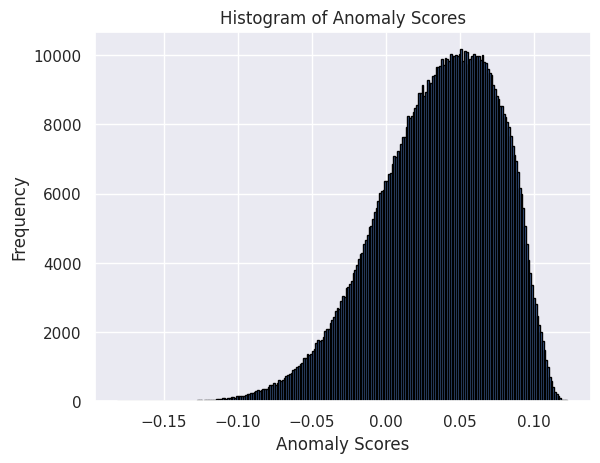

In [16]:
import matplotlib.pyplot as plt

# Plot histogram
plt.hist(anomaly_scores, bins='auto', edgecolor='black')

# Set labels and title
plt.xlabel('Anomaly Scores')
plt.ylabel('Frequency')
plt.title('Histogram of Anomaly Scores')

# Show the plot
plt.show()
